# Segmentação de imagens

Segmentar uma imagem significa **classificar cada um dos seus pixels** de acordo com as categorias que o modelo de IA conhece.

Vamos testar um exemplo com o modelo de classificação de fotos urbanas da NVIDIA: https://huggingface.co/nvidia/segformer-b1-finetuned-cityscapes-1024-1024

In [1]:
from transformers import pipeline

modelo = "nvidia/segformer-b1-finetuned-cityscapes-1024-1024"
segmentador = pipeline("image-segmentation", model=modelo)

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.
/home/juliano/.cache/pypoetry/virtualenvs/ias_para_imagens,_áudio_e_vídeo_no_hugging-hFrc_0yz-py3.11/lib/python3.11/site-packages/transformers/models/segformer/image_processing_segformer.py:103: FutureWarning: The `reduce_labels` parameter is deprecated and will be removed in a future version. Please use `do_reduce_labels` instead.
  warnings.warn(


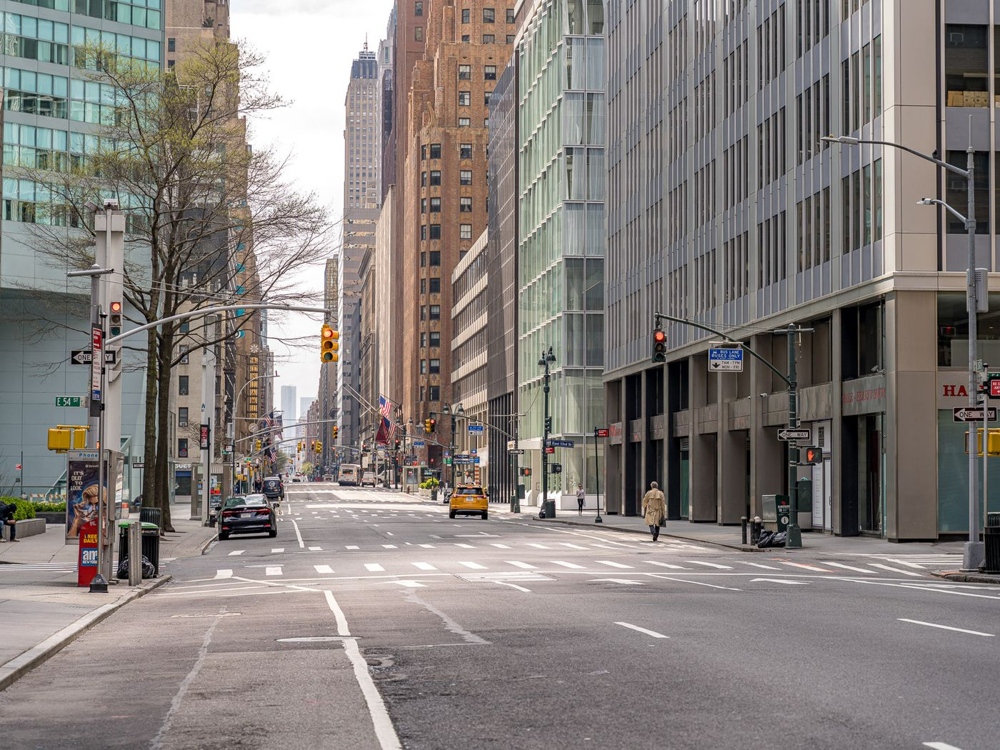

In [36]:
from pathlib import Path
from PIL import Image

imagem = Image.open(Path('imagens/cidades/city.jpg'))
imagem

In [37]:
segmentacao = segmentador(imagem)

In [38]:
segmentacao

[{'score': None,
  'label': 'road',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'sidewalk',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'building',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'wall',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'fence',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'pole',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'traffic light',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'traffic sign',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'vegetation',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label': 'terrain',
  'mask': <PIL.Image.Image image mode=L size=1400x1050>},
 {'score': None,
  'label

O modelo parece ter retornado várias imagens, mas o que são?

In [39]:
segmentacao_estrada = segmentacao[0]

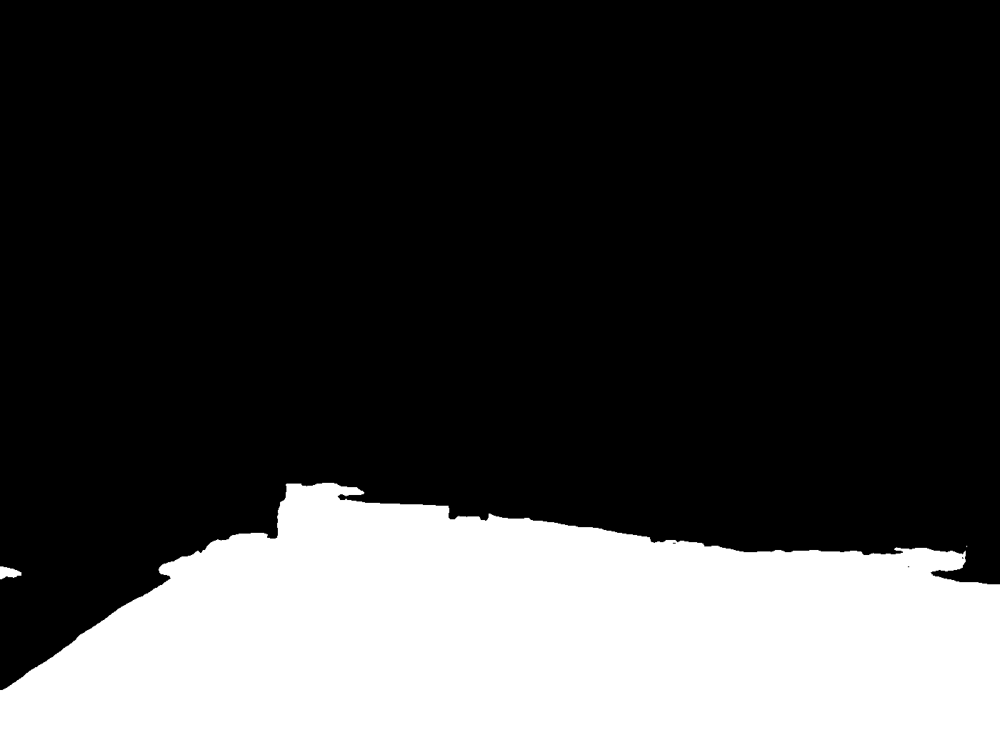

In [40]:
segmentacao_estrada['mask']

A segmentação na realidade cria uma **máscara**: uma imagem preenchida por valores 0 e 255, onde 255 = branco = pixel daquele atributo!

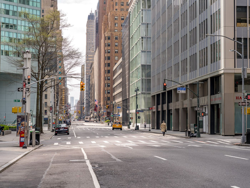

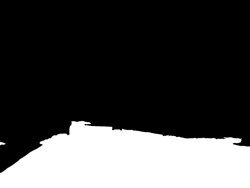

In [41]:
thumb_imagem = imagem.copy()
thumb_imagem.thumbnail((250, 250))
display(thumb_imagem)

thumb_mascara = segmentacao_estrada['mask'].copy()
thumb_mascara.thumbnail((250, 250))
display(thumb_mascara)

## Adicionando a máscara na imagem original

Parece que o modelo segmentou muito bem a estrada! Vamos criar um pequeno código para sobrepor a segmentação da estrada na imagem original:

In [42]:
import matplotlib.pyplot as plt
import numpy as np

dados_imagem = np.array(imagem)
dados_mascara = np.array(segmentacao_estrada['mask'])

In [43]:
print(dados_imagem.shape)
print(dados_imagem)

(1050, 1400, 3)
[[[150 165 168]
  [146 161 164]
  [149 164 167]
  ...
  [119 118 126]
  [118 117 125]
  [117 116 124]]

 [[152 167 170]
  [148 163 166]
  [151 166 169]
  ...
  [119 118 126]
  [118 117 125]
  [117 116 124]]

 [[153 168 171]
  [150 165 168]
  [153 168 171]
  ...
  [117 116 124]
  [117 116 124]
  [116 115 123]]

 ...

 [[104 100 101]
  [ 96  92  93]
  [ 94  90  91]
  ...
  [123 121 126]
  [126 124 129]
  [137 135 140]]

 [[ 98  94  95]
  [103  99 100]
  [103  99 100]
  ...
  [120 118 123]
  [126 124 129]
  [134 132 137]]

 [[102  98  99]
  [106 102 103]
  [107 103 104]
  ...
  [120 118 123]
  [126 124 129]
  [133 131 136]]]


In [44]:
print(dados_mascara.shape)
print(dados_mascara)

(1050, 1400)
[[  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 [  0   0   0 ...   0   0   0]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]


In [45]:
imagem_mascarada = dados_imagem & dados_mascara[:, :, np.newaxis]  # Preciso adicionar dimensão para o numpy não reclamar
imagem_mascarada

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       ...,

       [[104, 100, 101],
        [ 96,  92,  93],
        [ 94,  90,  91],
        ...,
        [123, 121, 126],
        [126, 124, 129],
        [137, 135, 140]],

       [[ 98,  94,  95],
        [103,  99, 100],
        [103,  99, 100],
        ...,
        [120, 118, 123],
        [126, 124, 129],
        [134, 132, 137]],

       [[102,  98,  99],
        [106, 102, 103],
        [107, 103, 104],
        ...,
        [120, 118, 123],
        [126, 124, 129],
        [133, 131, 136]]

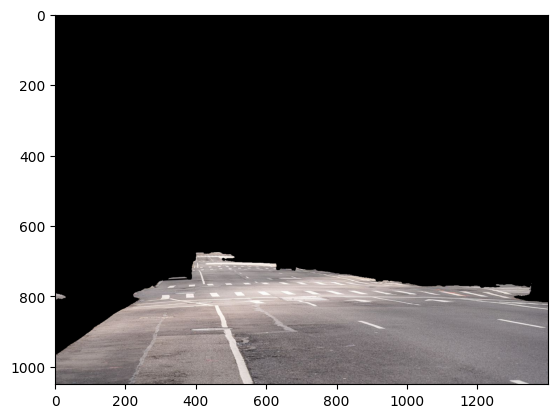

In [46]:
plt.imshow(imagem_mascarada)

Na verdade, queremos o contrário disso:

In [47]:
mascara_invertida = np.bitwise_not(dados_mascara)
imagem_mascarada = dados_imagem & mascara_invertida[:, :, np.newaxis]
imagem_mascarada

array([[[150, 165, 168],
        [146, 161, 164],
        [149, 164, 167],
        ...,
        [119, 118, 126],
        [118, 117, 125],
        [117, 116, 124]],

       [[152, 167, 170],
        [148, 163, 166],
        [151, 166, 169],
        ...,
        [119, 118, 126],
        [118, 117, 125],
        [117, 116, 124]],

       [[153, 168, 171],
        [150, 165, 168],
        [153, 168, 171],
        ...,
        [117, 116, 124],
        [117, 116, 124],
        [116, 115, 123]],

       ...,

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]]

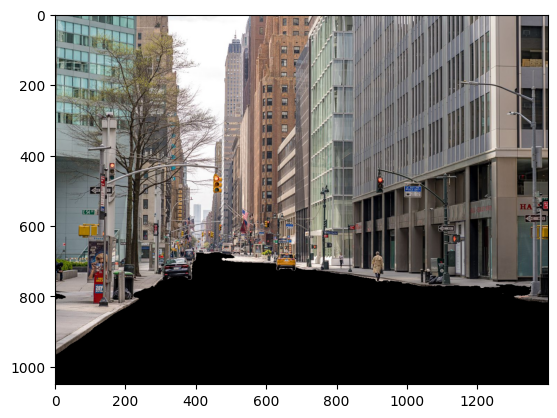

In [48]:
plt.imshow(imagem_mascarada)

Sucesso! Parece que o modelo detectou corretamente o local "estrada". O problema é que a estrada sumiu na visualização final.

## Adicionando todas as máscaras

Criar a lógica para sobrepor cada máscara, adicionar uma cor própria com transparência é algo relativamente complexo. Por sorte, no pacote scikit-image, temos essa funcionalidade já implementada:

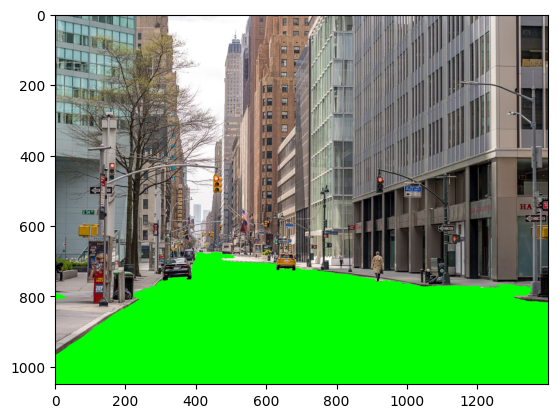

In [54]:
cor = np.array([0, 255, 0])  # Verde puro

imagem_mascara = dados_imagem.copy()
imagem_mascara = np.where(dados_mascara[:, :, np.newaxis] == 255, cor, imagem_mascara).astype(dados_imagem.dtype)

plt.imshow(imagem_mascara)

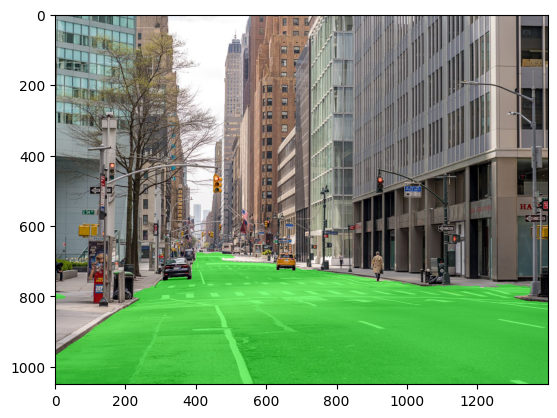

In [55]:
import cv2

imagem_combinada = cv2.addWeighted(dados_imagem, 0.5, imagem_mascara, 0.5, 0)
plt.imshow(imagem_combinada)

Podemos agora transformar isso em uma função e plotar todas as segmentações. Além disso, vamos aumentar a imagem e adicionar uma legenda com as cores:

In [69]:
def adicionar_mascara(dados_imagem, dados_mascara, cor):
    imagem_mascara = dados_imagem.copy()
    imagem_mascara = np.where(dados_mascara[:, :, np.newaxis] == 255, cor, imagem_mascara).astype(dados_imagem.dtype)
    return cv2.addWeighted(dados_imagem, 0.5, imagem_mascara, 0.5, 0)

In [70]:
valores = np.linspace(0, 1, len(segmentacao))
valores

array([0.        , 0.07142857, 0.14285714, 0.21428571, 0.28571429,
       0.35714286, 0.42857143, 0.5       , 0.57142857, 0.64285714,
       0.71428571, 0.78571429, 0.85714286, 0.92857143, 1.        ])

In [77]:
from matplotlib import colormaps

nome_colormap = 'viridis'
cmap = colormaps.get_cmap('viridis')
cores = [cmap(x) for x in valores]
cores

[(0.267004, 0.004874, 0.329415, 1.0),
 (0.28291, 0.105393, 0.426902, 1.0),
 (0.275191, 0.194905, 0.496005, 1.0),
 (0.248629, 0.278775, 0.534556, 1.0),
 (0.212395, 0.359683, 0.55171, 1.0),
 (0.180629, 0.429975, 0.557282, 1.0),
 (0.153364, 0.497, 0.557724, 1.0),
 (0.127568, 0.566949, 0.550556, 1.0),
 (0.122312, 0.633153, 0.530398, 1.0),
 (0.175707, 0.6979, 0.491033, 1.0),
 (0.288921, 0.758394, 0.428426, 1.0),
 (0.449368, 0.813768, 0.335384, 1.0),
 (0.626579, 0.854645, 0.223353, 1.0),
 (0.814576, 0.883393, 0.110347, 1.0),
 (0.993248, 0.906157, 0.143936, 1.0)]

In [78]:
cores = [(np.array(cor[:3]) * 255).astype(int) for cor in cores]
cores

[array([68,  1, 84]),
 array([ 72,  26, 108]),
 array([ 70,  49, 126]),
 array([ 63,  71, 136]),
 array([ 54,  91, 140]),
 array([ 46, 109, 142]),
 array([ 39, 126, 142]),
 array([ 32, 144, 140]),
 array([ 31, 161, 135]),
 array([ 44, 177, 125]),
 array([ 73, 193, 109]),
 array([114, 207,  85]),
 array([159, 217,  56]),
 array([207, 225,  28]),
 array([253, 231,  36])]

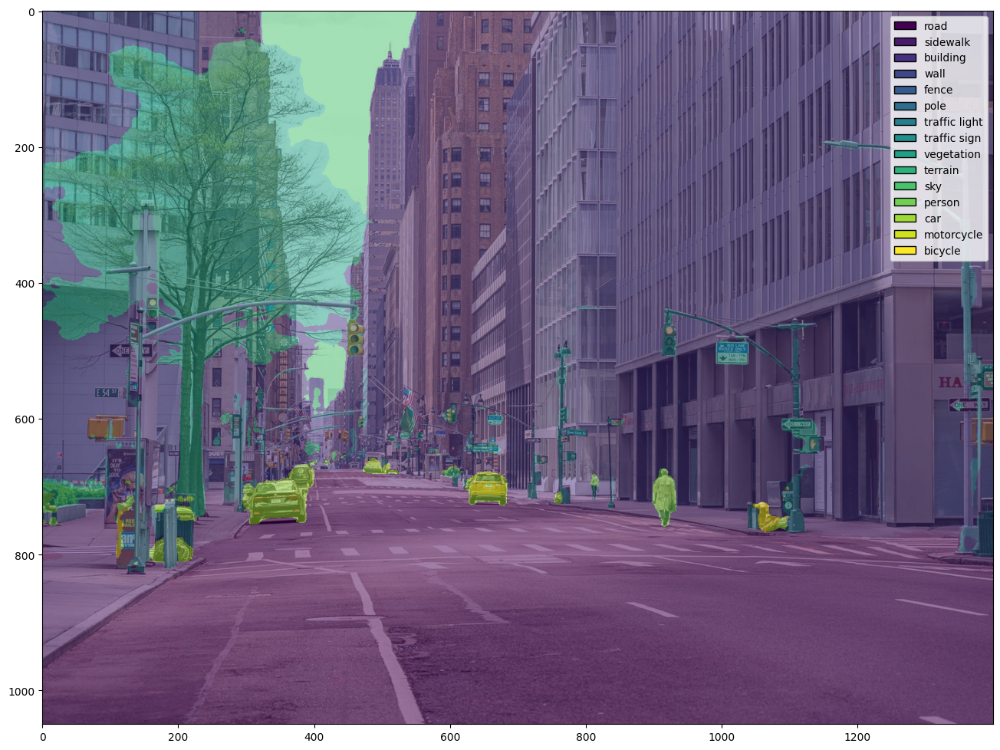

In [86]:
from matplotlib.patches import Patch

imagem_final = dados_imagem.copy()  # placeholder inicial

legendas = []
for segmento, cor in zip(segmentacao, cores):
    dados_mascara = np.array(segmento['mask'])
    label_mascara = segmento['label']
    imagem_final = adicionar_mascara(imagem_final, dados_mascara, cor)
    legendas.append(Patch(facecolor=cor/255, edgecolor='black', label=label_mascara))

fig, ax = plt.subplots(figsize=(16, 16))
plt.legend(handles=legendas)

ax.imshow(imagem_final)

## Código completo

In [4]:
from pathlib import Path

import cv2
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib import colormaps
from matplotlib.patches import Patch
import numpy as np
from transformers import pipeline

# Carregar modelo
modelo = "nvidia/segformer-b1-finetuned-cityscapes-1024-1024"
segmentador = pipeline("image-segmentation", model=modelo)

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration. Please open a PR/issue to update `preprocessor_config.json` to use `image_processor_type` instead of `feature_extractor_type`. This warning will be removed in v4.40.


In [5]:
def adicionar_mascara(dados_imagem, dados_mascara, cor):
    imagem_mascara = dados_imagem.copy()
    imagem_mascara = np.where(
        dados_mascara[:, :, np.newaxis] == 255, 
        cor, 
        imagem_mascara,
    ).astype(dados_imagem.dtype)
    return cv2.addWeighted(dados_imagem, 0.5, imagem_mascara, 0.5, 0)


def plotar_segmentos(imagem, segmentacao, nome_colormap):
    # Pegar cores de output
    cmap = colormaps.get_cmap(nome_colormap)
    cores = [
        (np.array(cmap(x)[:3]) * 255).astype(int) 
        for x in np.linspace(0, 1, len(segmentacao))
    ]
    
    # Apresentar output em imagem de saída
    imagem_final = np.array(imagem).copy()
    legendas = []
    for segmento, cor in zip(segmentacao, cores):
        dados_mascara = np.array(segmento['mask'])
        label_mascara = segmento['label']
        imagem_final = adicionar_mascara(imagem_final, dados_mascara, cor)
        legendas.append(Patch(facecolor=cor/255, edgecolor='black', label=label_mascara))
    
    fig, ax = plt.subplots(figsize=(16, 16))
    plt.legend(handles=legendas)
    
    ax.imshow(imagem_final)

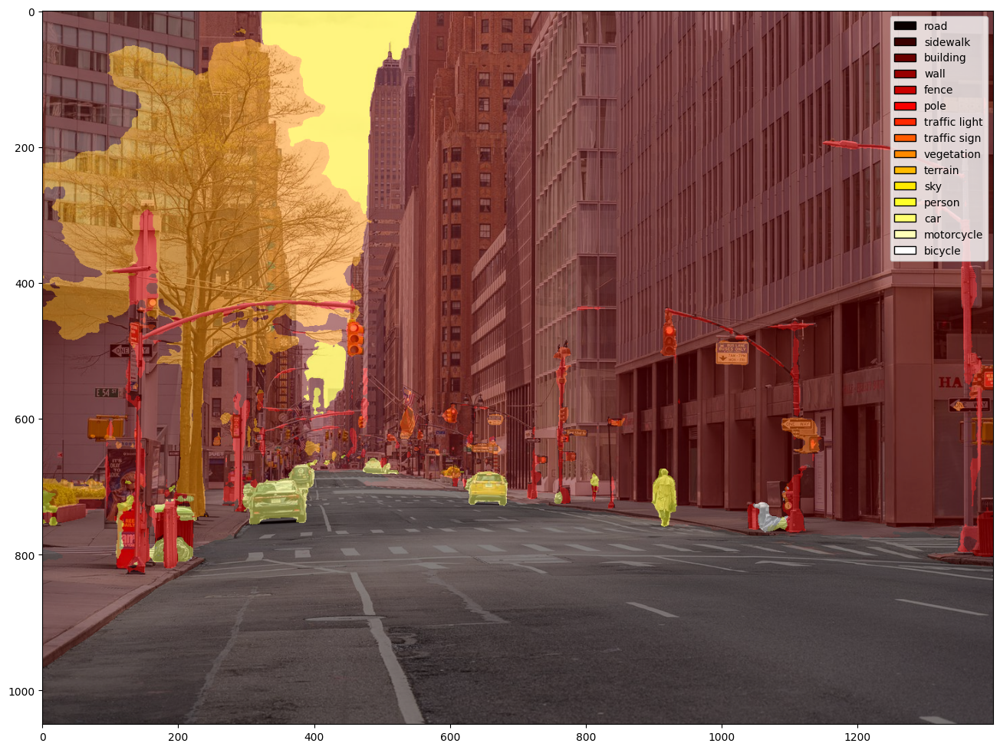

In [6]:
# Carregar dados de entrada
nome_colormap = 'hot'
imagem = Image.open(Path('imagens/cidades/city.jpg'))

# Rodar modelo
segmentacao = segmentador(imagem)

# Mostrar resultados
plotar_segmentos(imagem=imagem, segmentacao=segmentacao, nome_colormap=nome_colormap)

Testando com colormaps qualitativos (https://matplotlib.org/stable/gallery/color/colormap_reference.html):

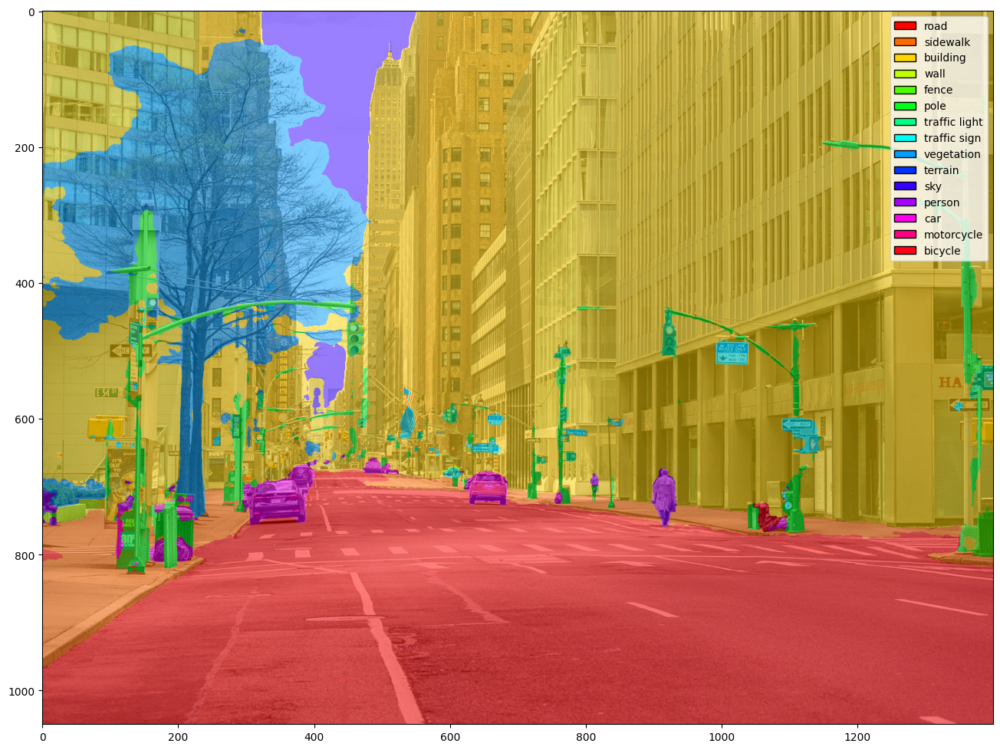

In [7]:
plotar_segmentos(imagem=imagem, segmentacao=segmentacao, nome_colormap='hsv')

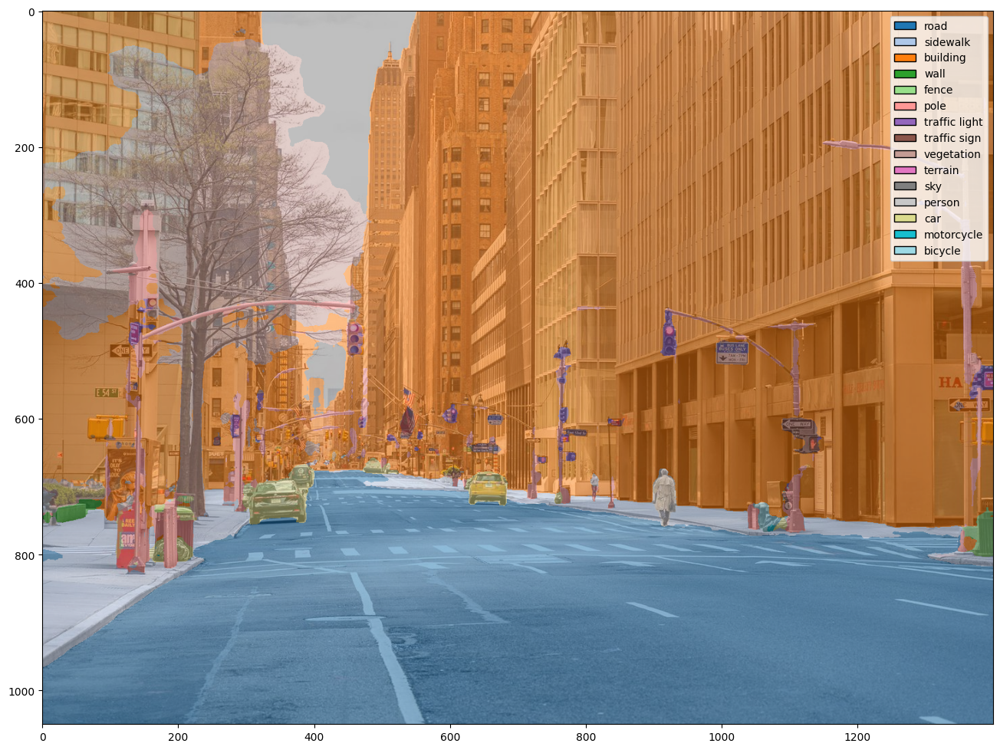

In [8]:
plotar_segmentos(imagem=imagem, segmentacao=segmentacao, nome_colormap='tab20')

Testando com outras imagens:

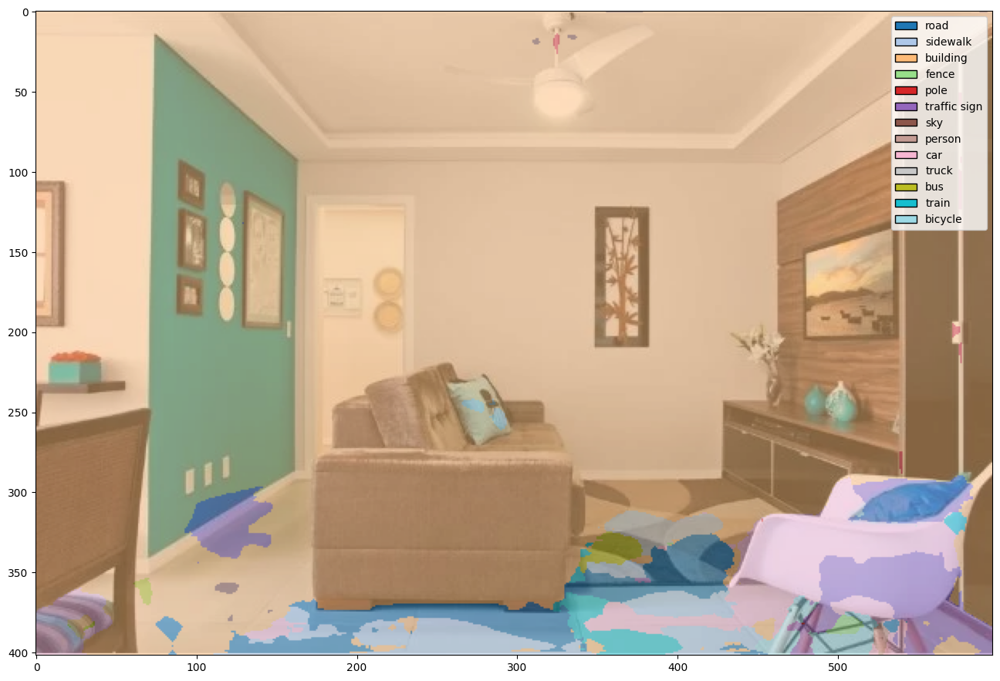

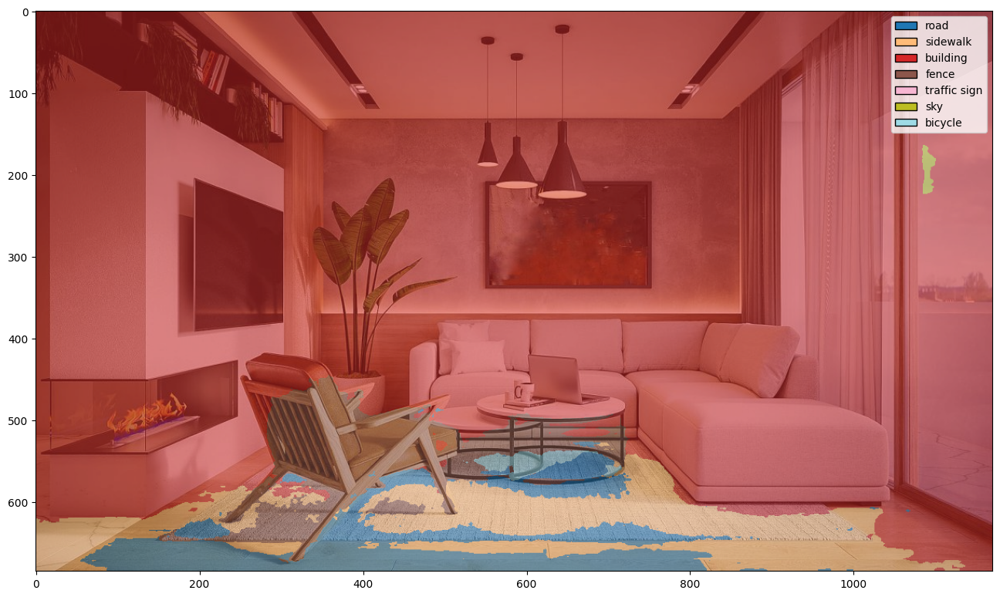

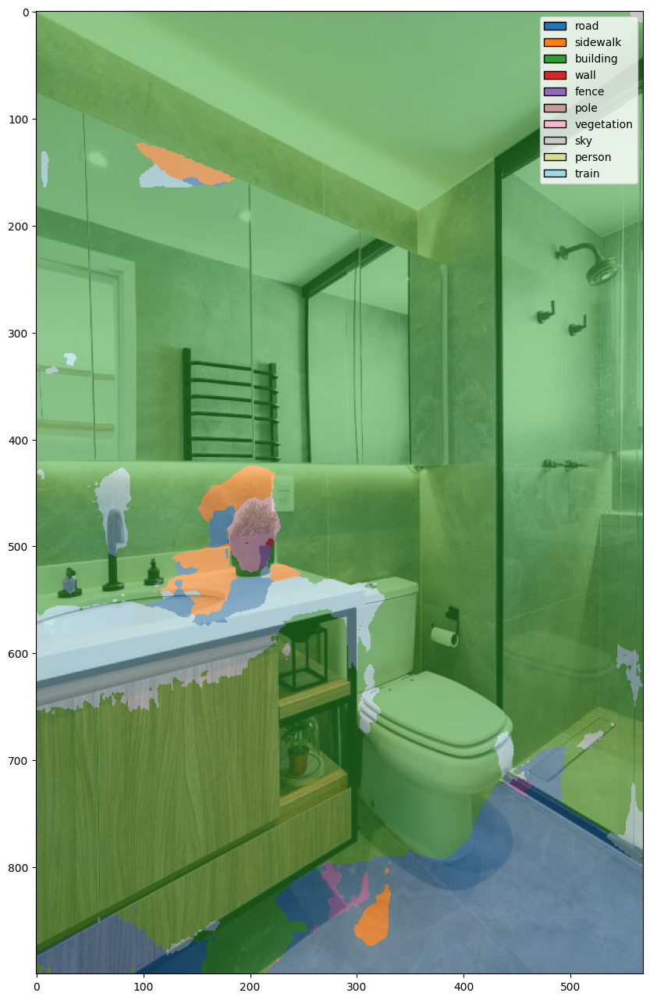

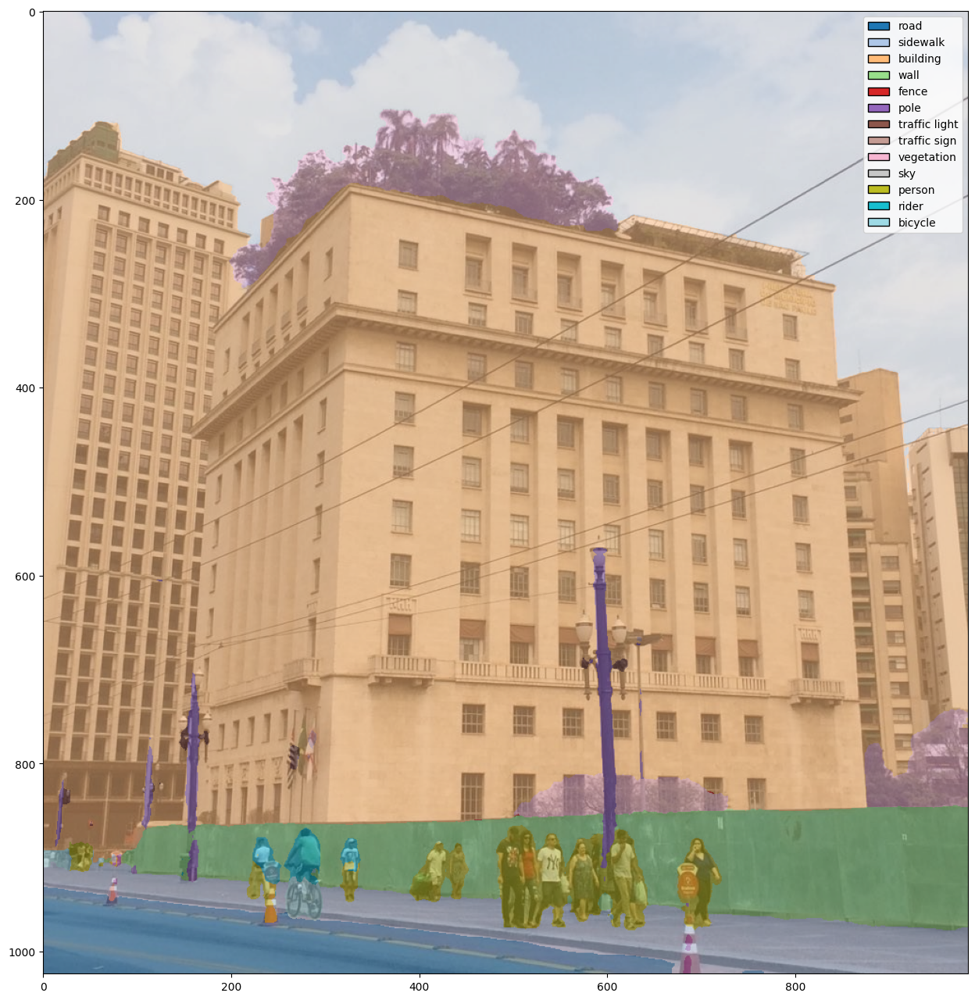

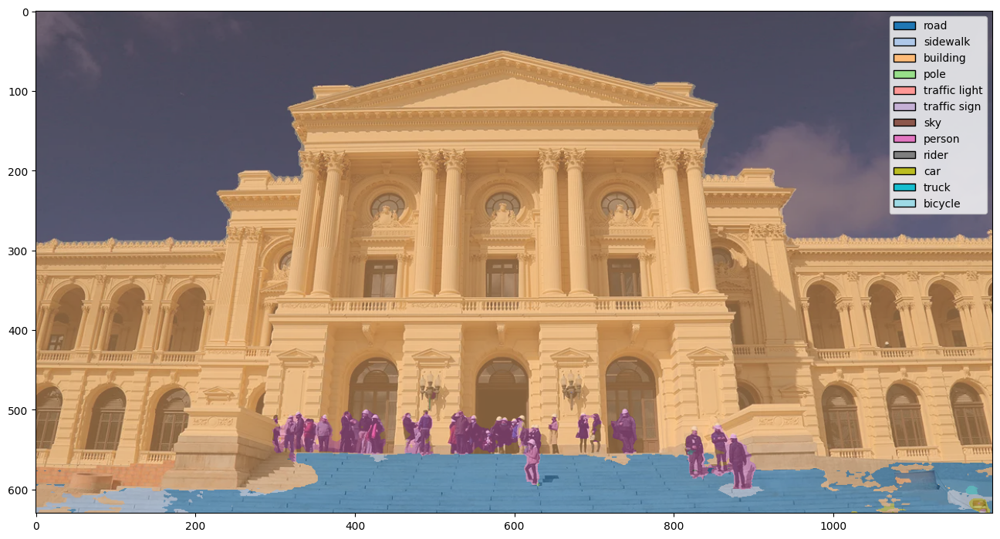

...

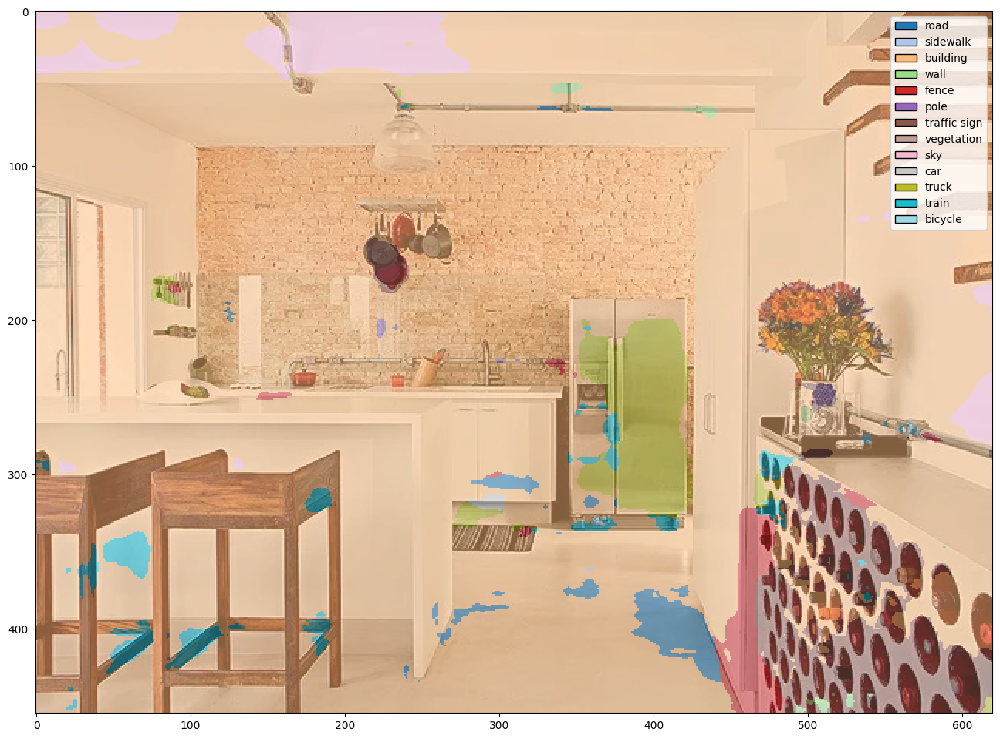

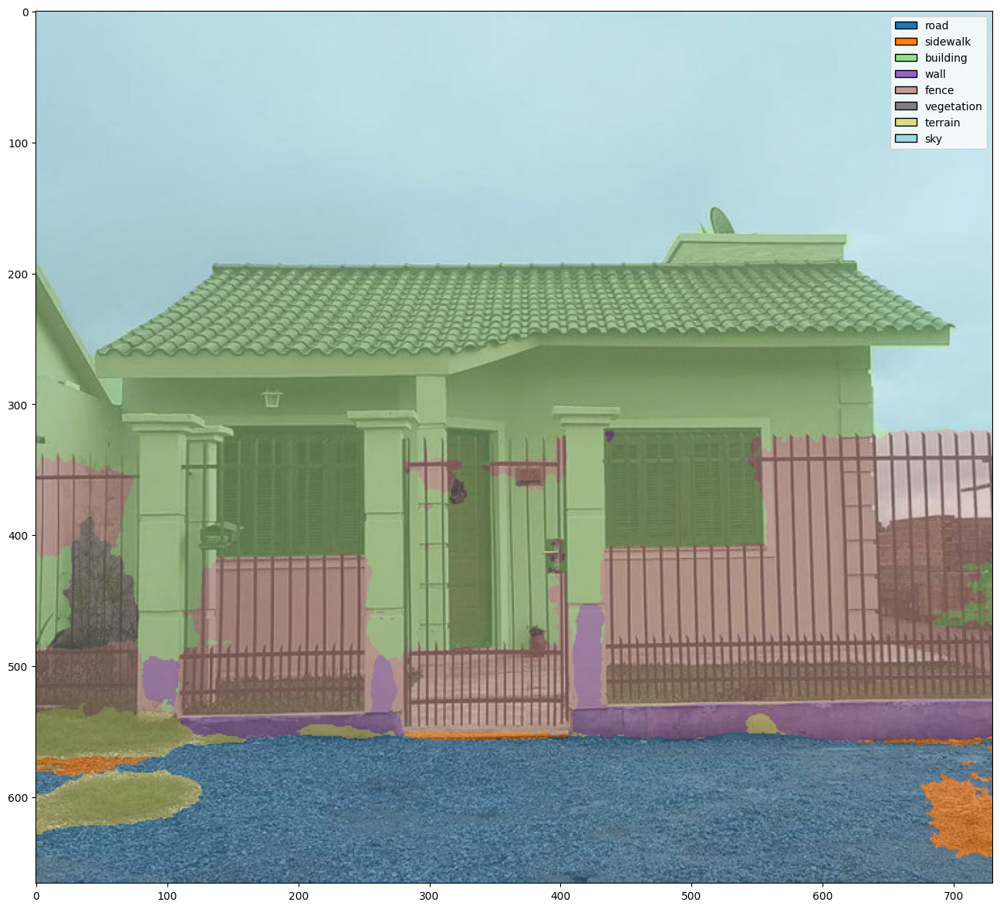

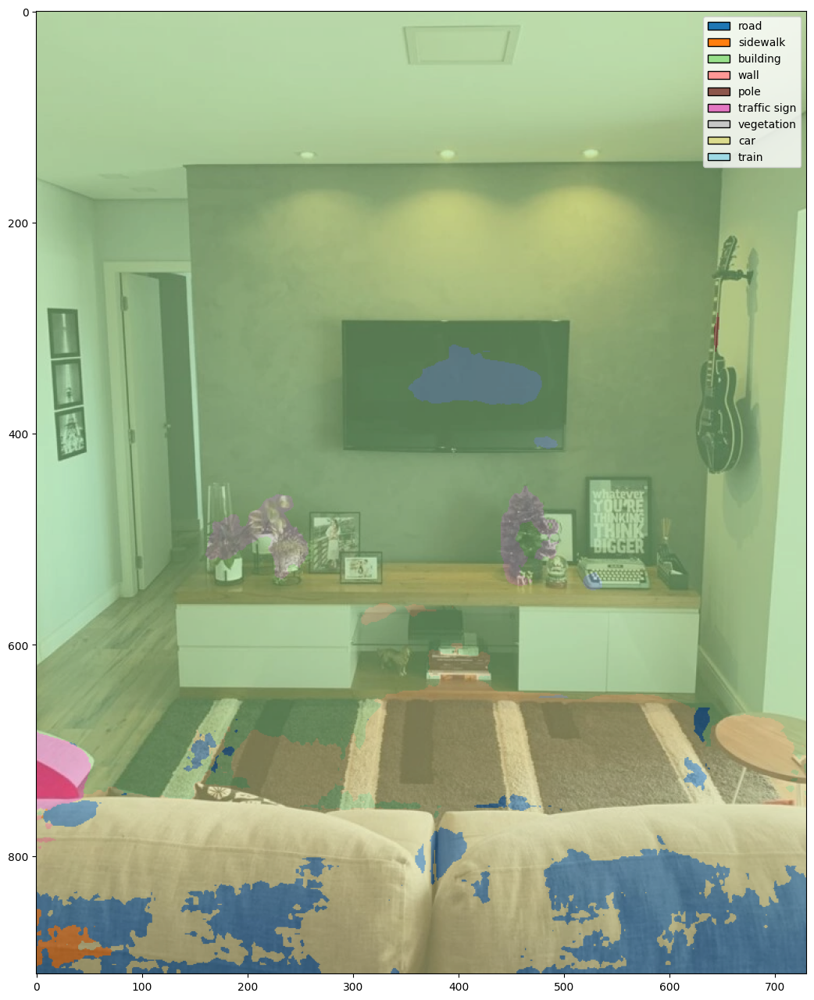

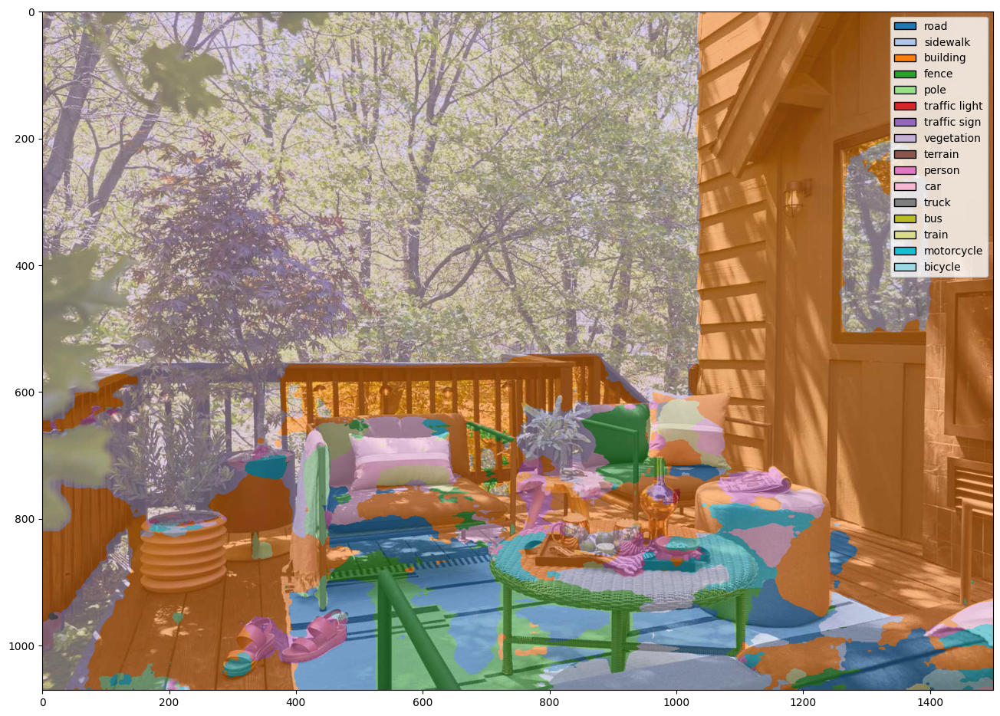

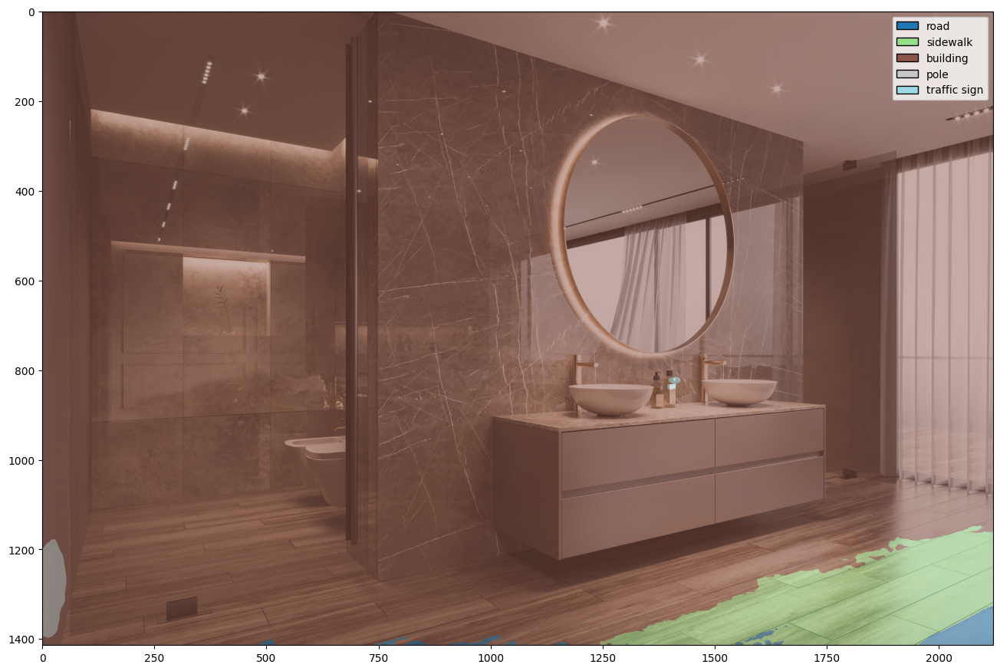

In [10]:
# Carregar dados de entrada
nome_colormap = 'tab20'

imagens = [Image.open(arquivo) for arquivo in Path('imagens/casas').iterdir()]
for imagem in imagens:    
    segmentacao = segmentador(imagem)
    plotar_segmentos(imagem=imagem, segmentacao=segmentacao, nome_colormap=nome_colormap)
    plt.show()

## Testando outros modelos

Segmentador de rosto: https://huggingface.co/jonathandinu/face-parsing

In [11]:
modelo = "jonathandinu/face-parsing"
segmentador = pipeline("image-segmentation", model=modelo)

config.json:   0%|          | 0.00/1.69k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/339M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/374 [00:00<?, ?B/s]

/home/juliano/.cache/pypoetry/virtualenvs/ias_para_imagens,_áudio_e_vídeo_no_hugging-hFrc_0yz-py3.11/lib/python3.11/site-packages/transformers/models/segformer/feature_extraction_segformer.py:28: FutureWarning: The class SegformerFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use SegformerImageProcessor instead.
  warnings.warn(


In [13]:
imagens = [Image.open(arquivo) for arquivo in Path('imagens/pessoas').iterdir()]
for imagem in imagens:
    segmentacao = segmentador(imagem)
    print(segmentacao)
    print('-----')

[{'score': None, 'label': 'background', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94CFFB5810>}, {'score': None, 'label': 'skin', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94D41D5ED0>}, {'score': None, 'label': 'nose', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94F1C1CD90>}, {'score': None, 'label': 'l_eye', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94F1C1D3D0>}, {'score': None, 'label': 'r_eye', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94F1C1E150>}, {'score': None, 'label': 'l_brow', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94F1C1C490>}, {'score': None, 'label': 'r_brow', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94F1C1C510>}, {'score': None, 'label': 'l_ear', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94EEA9FB90>}, {'score': None, 'label': 'mouth', 'mask': <PIL.Image.Image image mode=L size=1276x723 at 0x7D94EEA8CA10>}, {'score': None, 'label': 'u_lip

Parece ter funcionado e gerado o output no mesmo formato, portanto vamos reaproveitar o código anterior:

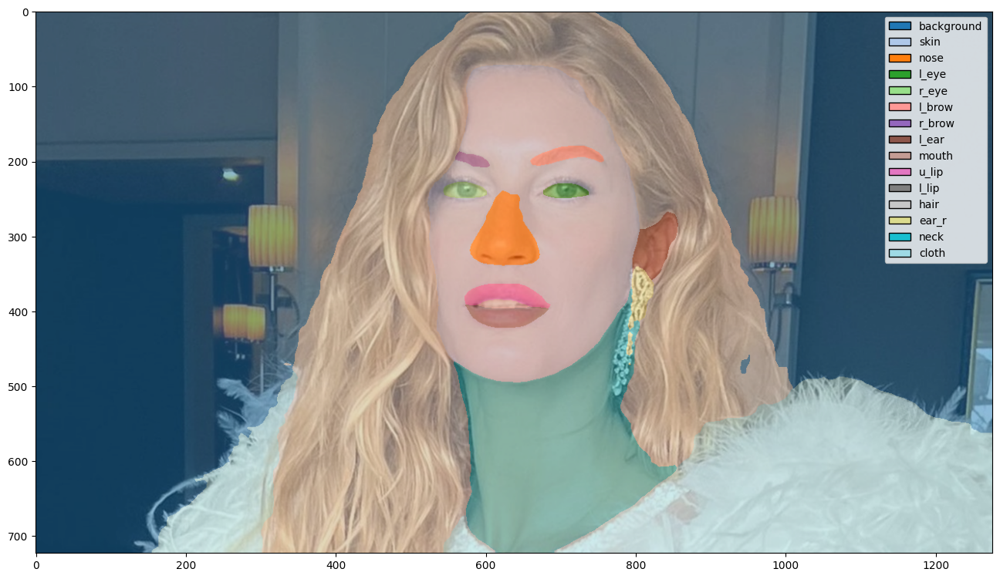

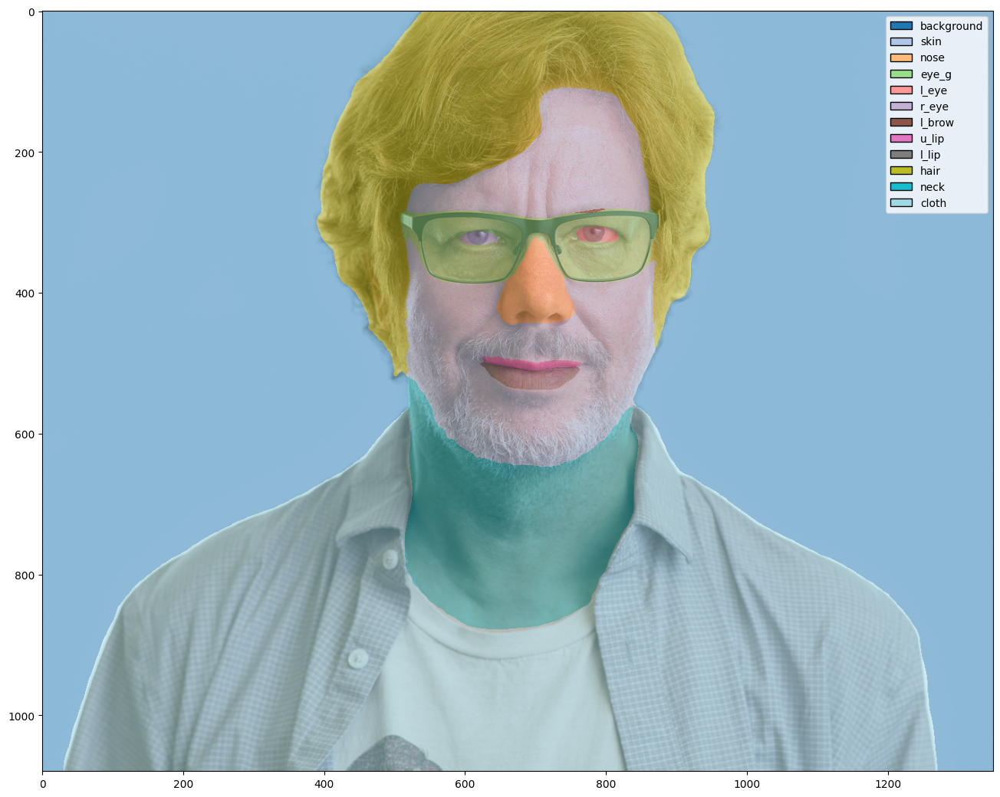

In [14]:
for imagem in imagens:    
    segmentacao = segmentador(imagem)
    plotar_segmentos(imagem=imagem, segmentacao=segmentacao, nome_colormap=nome_colormap)
    plt.show()